Experimental Dataset - 2D class - class 93 - 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
from scipy.stats import special_ortho_group
from scipy.optimize import curve_fit
from IPython.display import Image
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
fig_force_update_master=False

In [3]:
CLASS_NUMBER = 39
L            = 4
EPOCH_NUMBER = 160
CHECKPTH_KEY = 'cone_'
DATA_KEY     = 'class_2d_{}'.format(CLASS_NUMBER)
METADATA_KEY = 'class2D'

In [4]:
# no need to edit this cell
KEYWORD      = 'cryo_exp_{}_128x128'.format(DATA_KEY)
CHECKPT_FILE = 'cryo_exp_{}_l{}_{}epoch_{}_checkpoint.pth'.format(DATA_KEY,L,CHECKPTH_KEY,EPOCH_NUMBER)
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR     = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'{}_{}_sort.h5'.format(METADATA_KEY,CLASS_NUMBER)
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
#
print('> Storing results in {}'.format(KEYWORD))
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)
else:
    print('no need to copy {} again. Already found in {}/train_vae ...'.format(TRAINED_CHECKPOINT, KEYWORD))

> Storing results in cryo_exp_class_2d_39_128x128
no need to copy epoch_160_checkpoint.pth again. Already found in cryo_exp_class_2d_39_128x128/train_vae ...


# Load dataset, encoder and decoder

In [5]:
# this is juste convenient
fig_force_update=False
if fig_force_update_master:
    fig_force_update=True

dataset.shape (5119, 1, 128, 128) metadata.shape (5119, 180, 180)


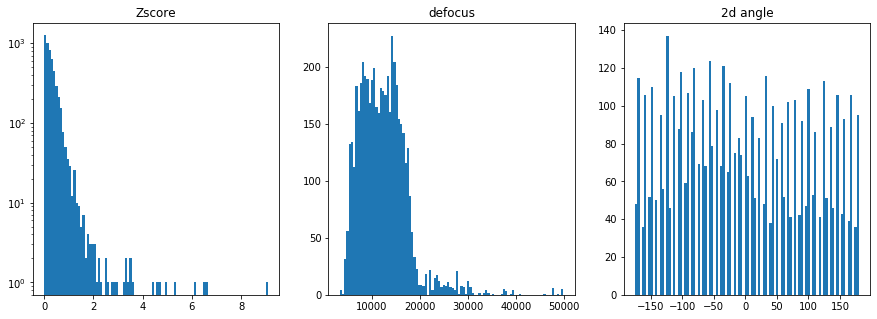

In [6]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
#
Zscore       = np.array(metadata['_rlnparticleselectzscore'])
defocus_true = np.array(metadata['_rlndefocusu'])
angle_true   = np.array(metadata['_rlnanglepsi'])
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))
#
fig = plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.title('Zscore')
plt.hist(Zscore, bins=100, log=True)
plt.subplot(1,3,2)
plt.title('defocus')
plt.hist(defocus_true, bins=100, log=False)
plt.subplot(1,3,3)
plt.title('2d angle')
plt.hist(angle_true, bins=100, log=False)
fig.savefig(KEYWORD+'/data.png')

In [7]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_160_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_160_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(5119, 4)

In [8]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_160_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_160_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

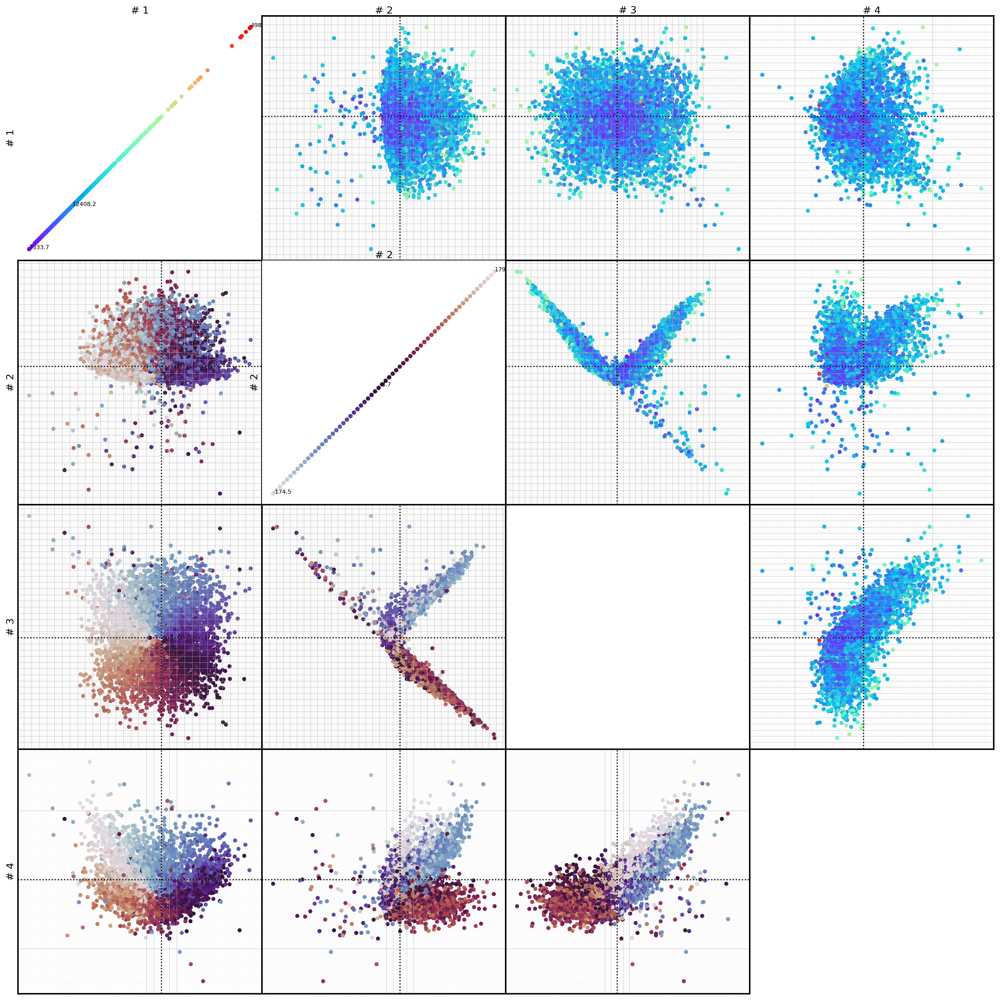

In [9]:
figname=KEYWORD+'/latent_space_biplot.png'
#
run_cell=False
show_png=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(mus, prj2=mus,
                n=4, nbins=100,
                c=defocus_true,
                c2=angle_true, c2map='twilight',
                show_histo=False,
                figname=figname
               )
Image(figname)

In [10]:
U, L, Vt = np.linalg.svd(mus - np.mean(mus,axis=0), full_matrices=False)

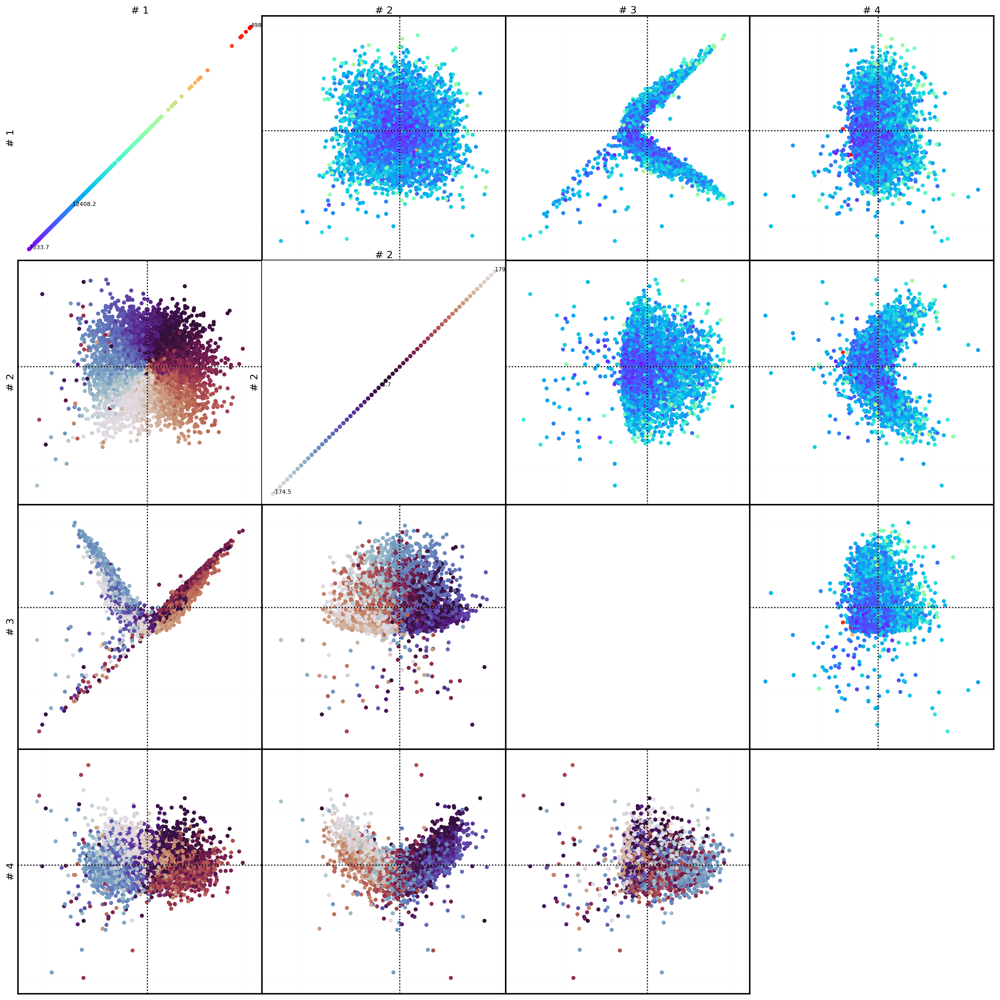

In [11]:
figname=KEYWORD+'/latent_space_pca_biplot.png'
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U, prj2=U,
                n=4, nbins=100,
                c=defocus_true,
                c2=angle_true, c2map='twilight',
                show_histo=False,
                figname=figname
               )
Image(figname)

# Data curation

In [12]:
# this is juste convenient
fig_force_update=False
if fig_force_update_master:
    fig_force_update=True

## Outlier prediction

In [13]:
Zscore_set        = 2
measure_threshold = 0.5
methods     = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
method_best = methods[1]

In [14]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print('True positives: {} | True negatives: {}'.format(positives.shape[0],negatives.shape[0]))

True positives: 5090 | True negatives: 29


AUC(robust_covar) = 0.8100467448004878 / offset=3
AUC(isolation_forest) = 0.8584445498272475 / offset=0.5
AUC(local_outlier_detection) = 0.8163471309531873 / offset=1.5


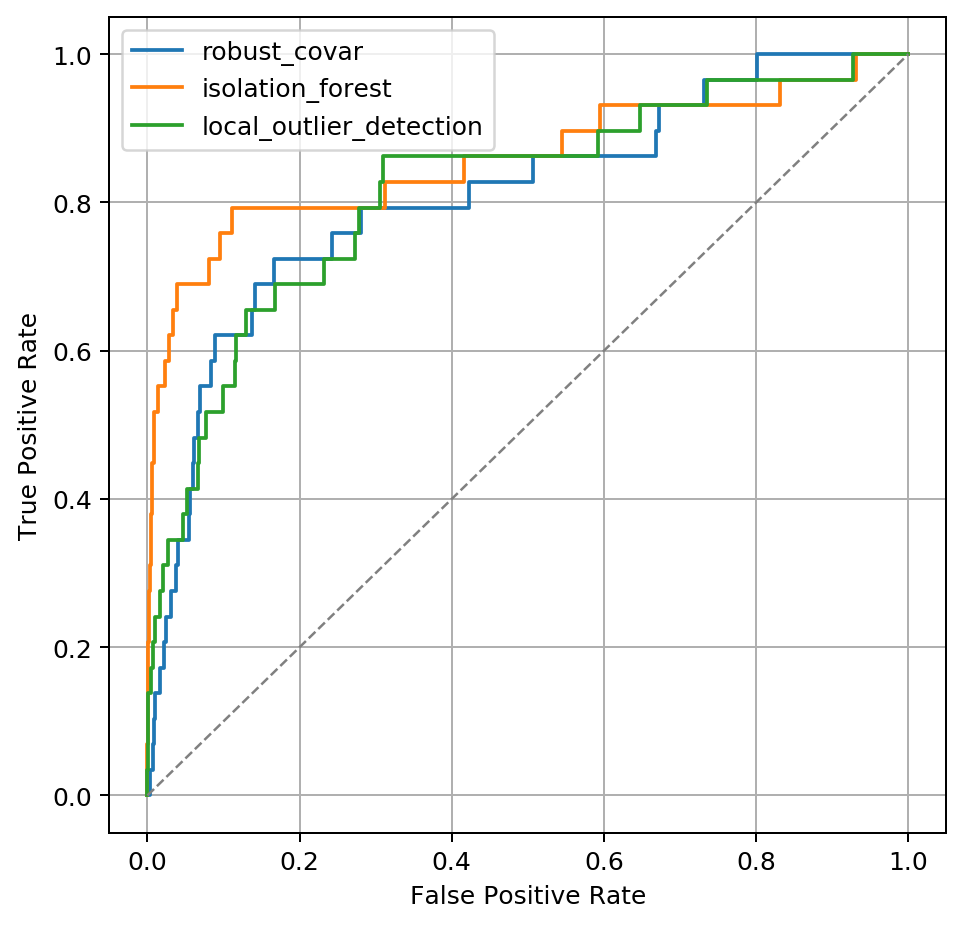

In [15]:
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {} / offset={}'.format(method, metrics.auc(fpr, tpr), offset))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#

In [16]:
measure, offset, assignment = pred.outlier_measure(mus, method=method_best)
index_kept = np.where(measure<measure_threshold,0,1)

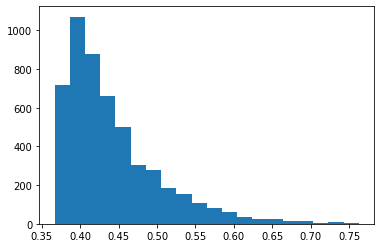

In [17]:
plt.hist(measure, bins=20)
plt.show()

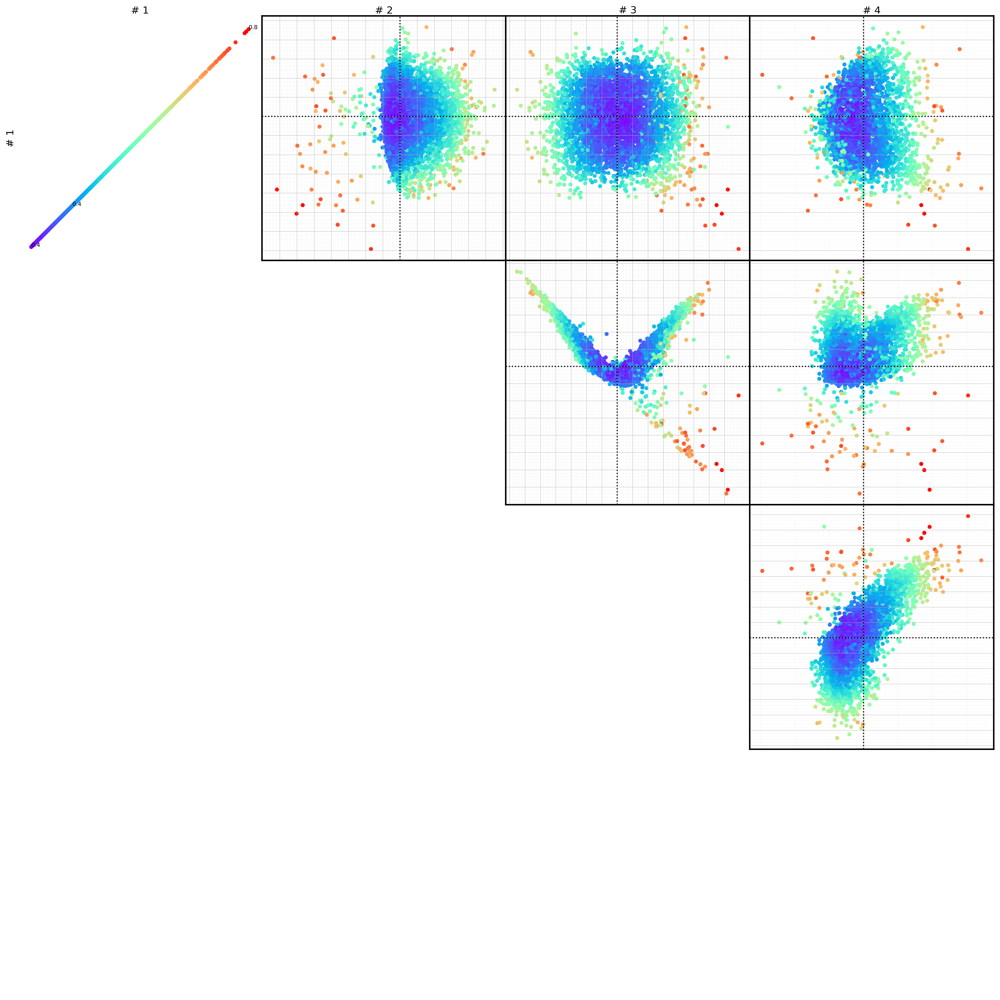

In [18]:
figname=KEYWORD+'/latent_space_{}_biplot.png'.format(method_best)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(mus, #prj2=U,
                n=4, nbins=100,
                c=measure,
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

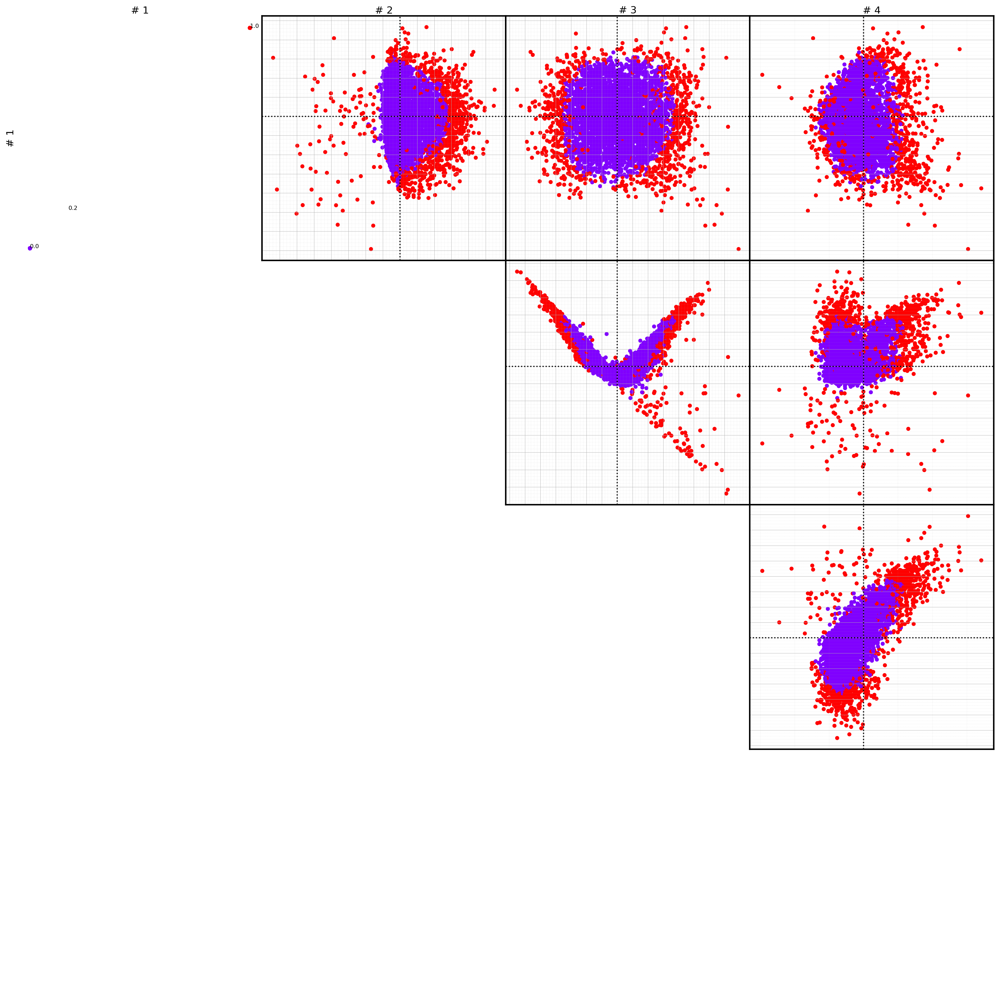

In [19]:
figname=KEYWORD+'/latent_space_{}_assigned_t{}_biplot.png'.format(method_best,measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(mus, #prj2=U,
                n=4, nbins=100,
                c=index_kept,
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

### check out outliers

In [20]:
mus_outlier     = mus[index_kept==1,:]
defocus_outlier = defocus_true[index_kept==1]
angle_outlier   = angle_true[index_kept==1]
Zscore_outlier  = Zscore[index_kept==1]
print(mus_outlier.shape)

(781, 4)


In [43]:
particles_outlier= np.array(metadata['particles'])[index_kept==1,...]

In [44]:
particles_outlier.shape

(781, 180, 180)

In [21]:
mus_kept     = mus[index_kept==0,:]
defocus_kept = defocus_true[index_kept==0]
angle_kept   = angle_true[index_kept==0]
Zscore_kept  = Zscore[index_kept==0]
print(mus_kept.shape)

(4338, 4)


In [45]:
particles_kept= np.array(metadata['particles'])[index_kept==0,...]
particles_kept.shape

(4338, 180, 180)

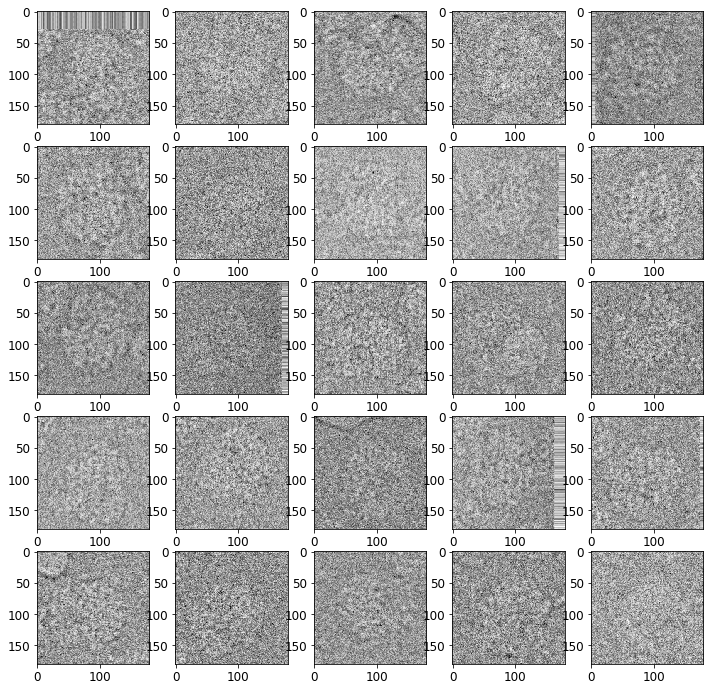

In [55]:
fig = plt.figure(figsize=(12,12))
for i in np.arange(25):
    plt.subplot(5,5,i+1)
    plt.imshow(particles_outlier[i,...], cmap='Greys_r')

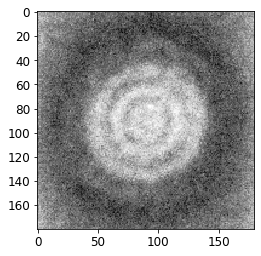

In [59]:
plt.imshow(np.mean(particles_outlier,axis=0), cmap='Greys_r')

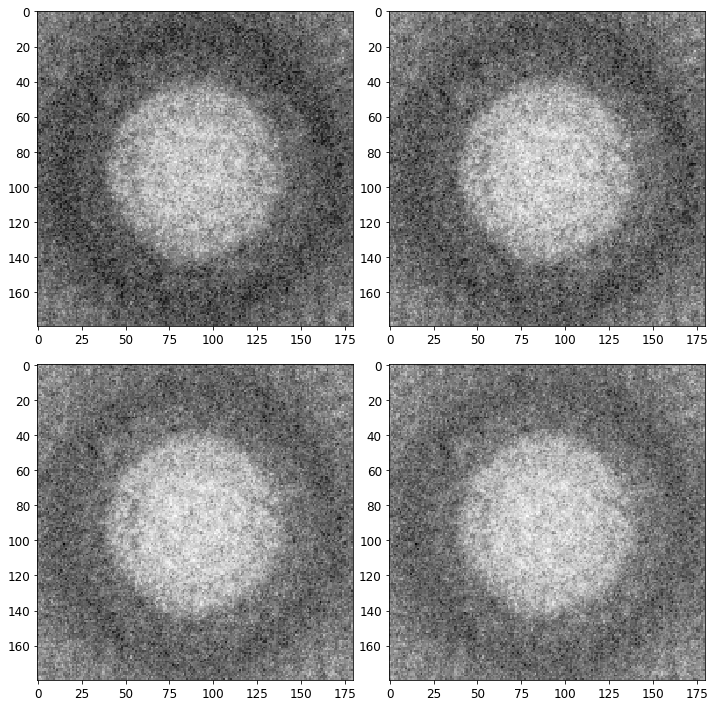

In [75]:
fig = plt.figure(figsize=(10,10))
i=0
for shift in np.arange(0,400,100):
    i+=1
    plt.subplot(2,2,i)
    plt.imshow(np.mean(particles_kept[shift:particles_outlier.shape[0]+shift,...],axis=0), cmap='Greys_r')
plt.tight_layout()

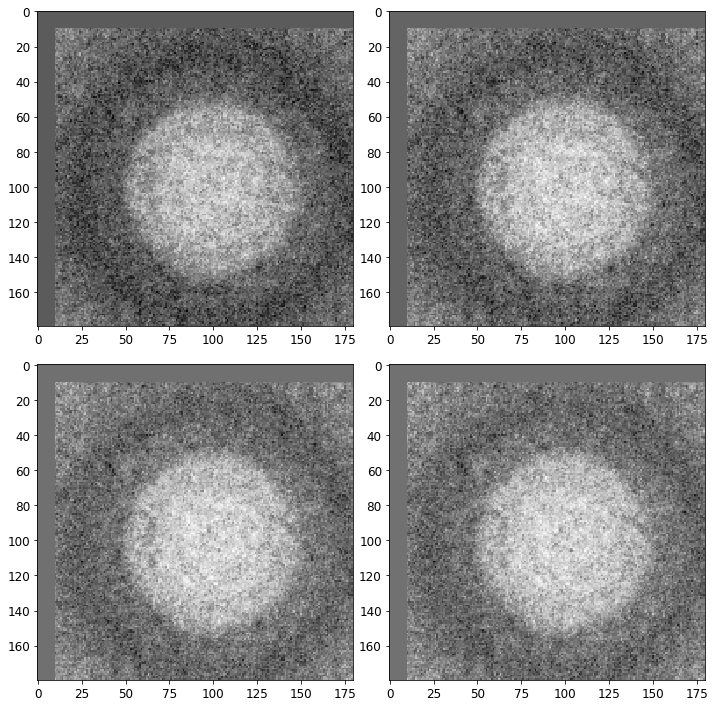

In [76]:
from scipy import ndimage
fig = plt.figure(figsize=(10,10))
i=0
for shift in np.arange(0,400,100):
    i+=1
    plt.subplot(2,2,i)
    plt.imshow(
                np.mean(
                  scipy.ndimage.shift(
                      particles_kept[shift:particles_outlier.shape[0]+shift,...],10),axis=0), 
                cmap='Greys_r')
plt.tight_layout()

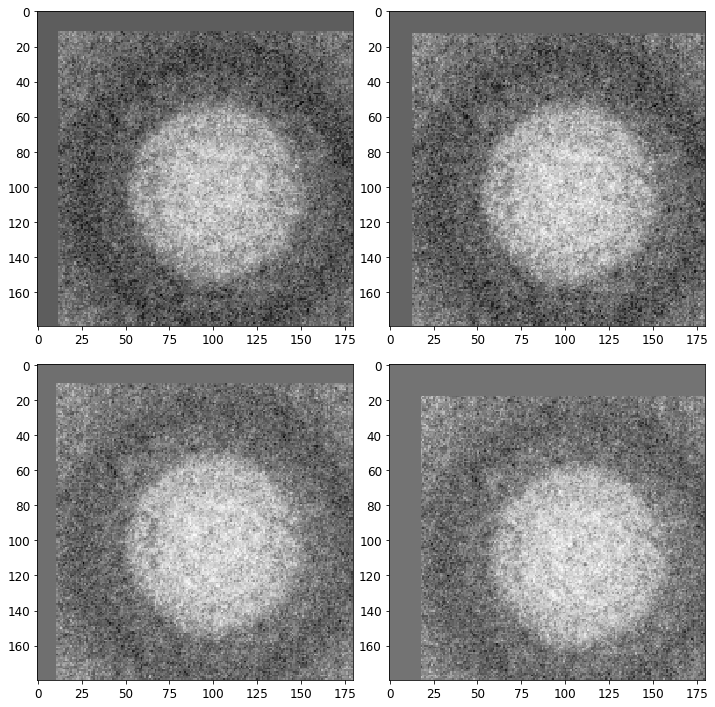

In [78]:
from scipy import ndimage
fig = plt.figure(figsize=(10,10))
i=0
for shift in np.arange(0,400,100):
    i+=1
    plt.subplot(2,2,i)
    plt.imshow(
                np.mean(
                  scipy.ndimage.shift(
                      particles_kept[shift:particles_outlier.shape[0]+shift,...],np.random.randint(10,20)),axis=0), 
                cmap='Greys_r')
plt.tight_layout()

In [97]:
shift = 35
particles_kept_randomshift = np.zeros((particles_outlier.shape))
for i in np.arange(particles_outlier.shape[0]):
    particles_kept_randomshift[i,...] = scipy.ndimage.shift(particles_kept[i,...],
                                                            (np.random.randint(-shift,shift),
                                                            np.random.randint(-shift,shift)))

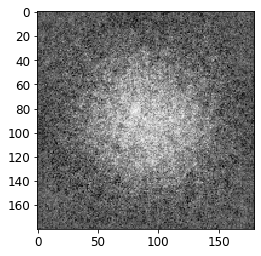

In [98]:
plt.imshow(np.mean(particles_kept_randomshift,axis=0), cmap='Greys_r')

In [ ]:
from scipy import ndimage
fig = plt.figure(figsize=(10,10))
i=0
for shift in np.arange(0,400,100):
    i+=1
    plt.subplot(2,2,i)
    plt.imshow(
                np.mean(
                  scipy.ndimage.shift(
                      particles_kept[shift:particles_outlier.shape[0]+shift,...],np.random.randint(-10,10)),axis=0), 
                cmap='Greys_r')
plt.tight_layout()

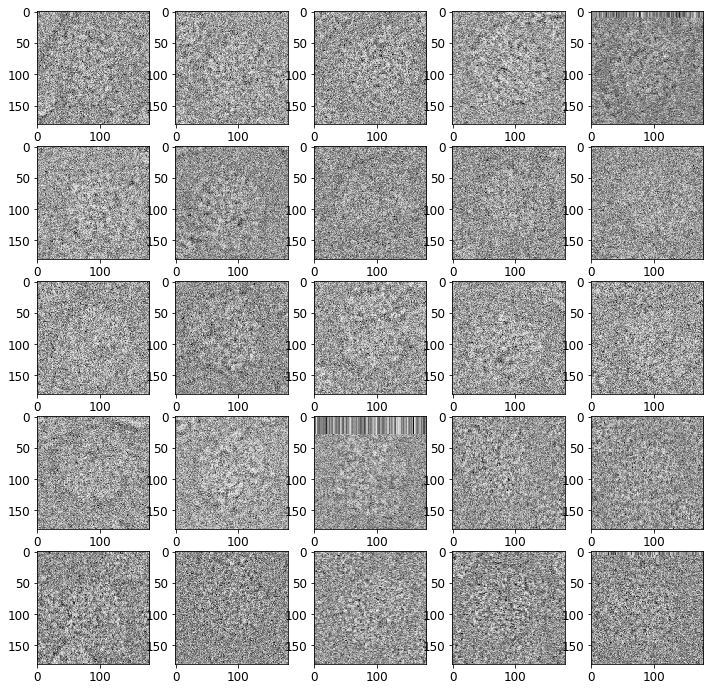

In [56]:
fig = plt.figure(figsize=(12,12))
for i in np.arange(25):
    plt.subplot(5,5,i+1)
    plt.imshow(particles_kept[i,...], cmap='Greys_r')

### back to the flow

## Remove user-defined outliers

In our case, knowledge of metadata helps getting rid of "bad" data (i.e. defocus values out of reasonable range)

In [22]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]
mus_curated     = mus_kept[index,:]
angle_curated   = angle_kept[index]
defocus_curated = defocus_kept[index]
Zscore_curated  = Zscore_kept[index]
print(mus_curated.shape)

(4185, 4)


In [23]:
U_curated, L_curated, Vt_curated = np.linalg.svd(mus_curated - np.mean(mus_curated,axis=0), full_matrices=False)

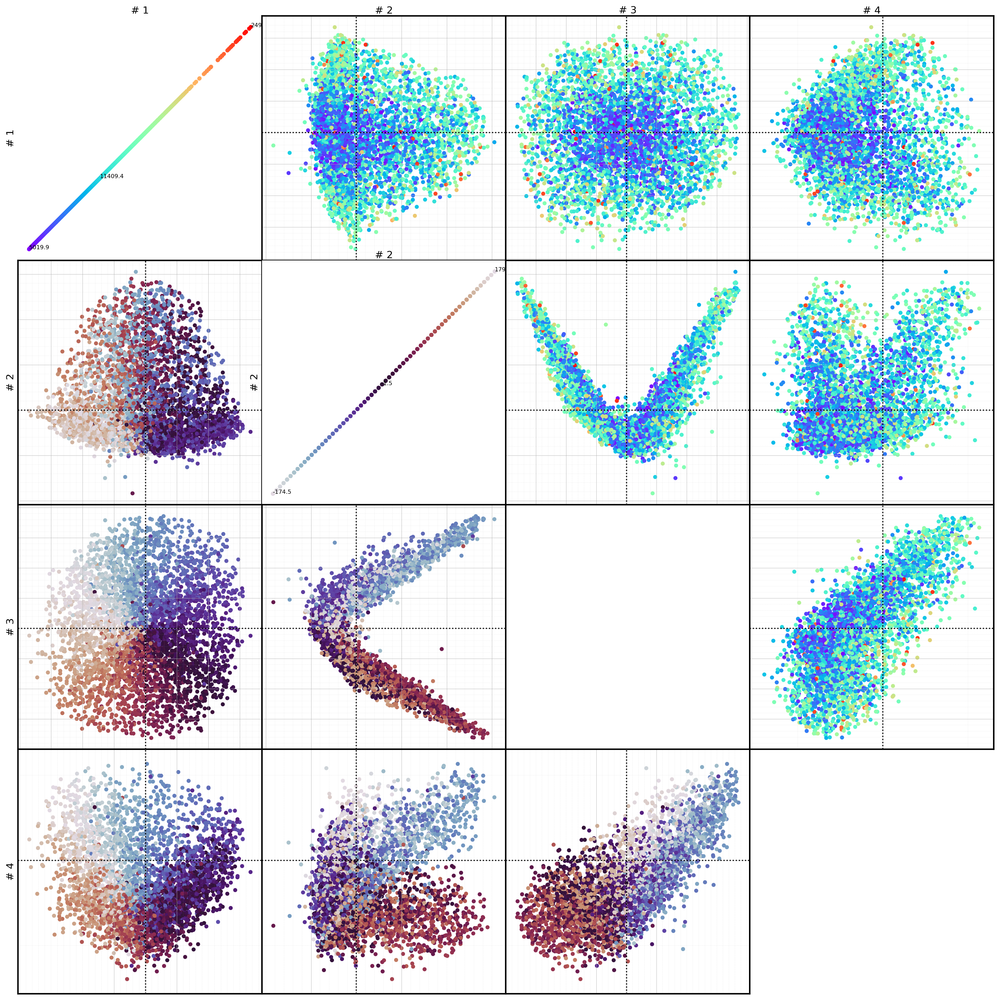

In [24]:
figname=KEYWORD+'/latent_space_curated_t{}_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(mus_curated, prj2=mus_curated,
                n=4, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                majortick=0.5,
                figname=figname
               )
Image(figname)

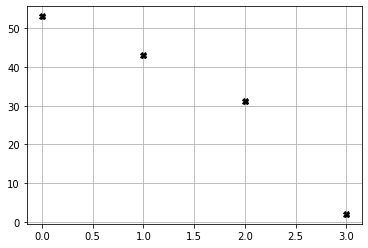

In [25]:
plt.plot(L_curated, 'Xk')
plt.grid()

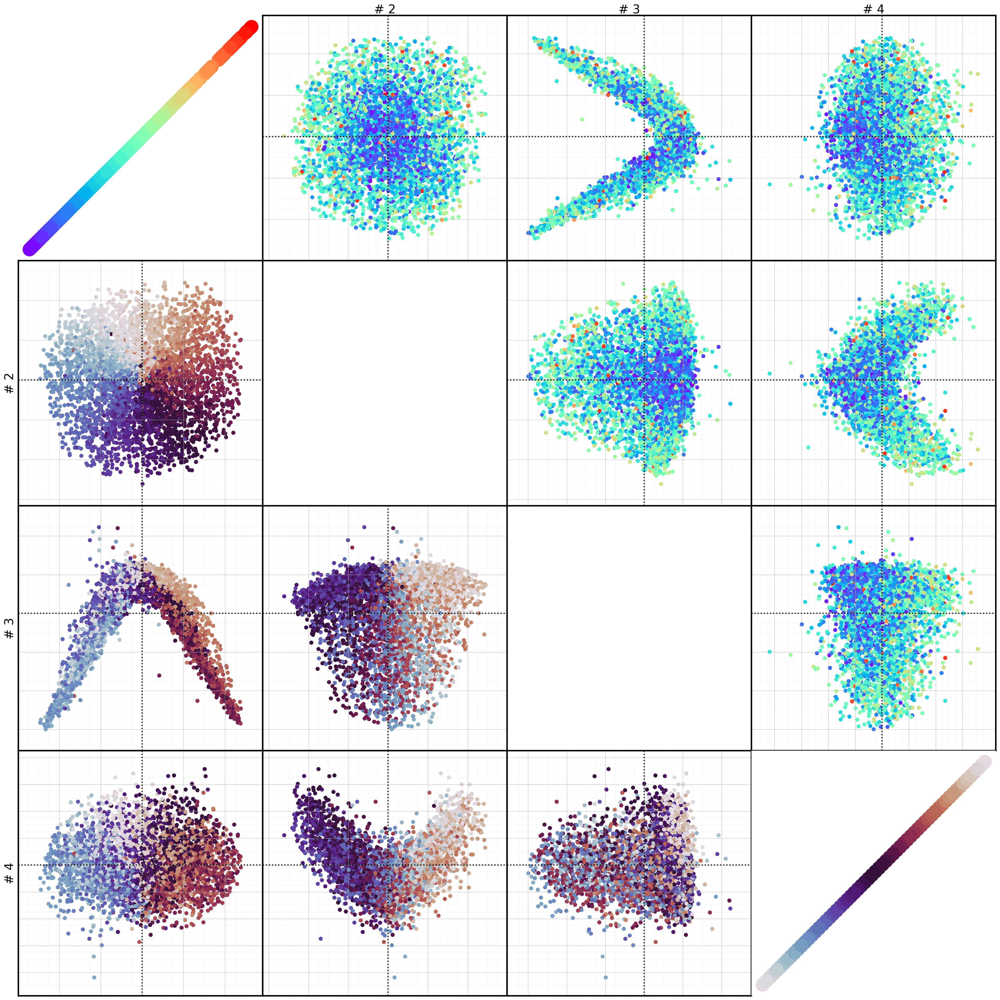

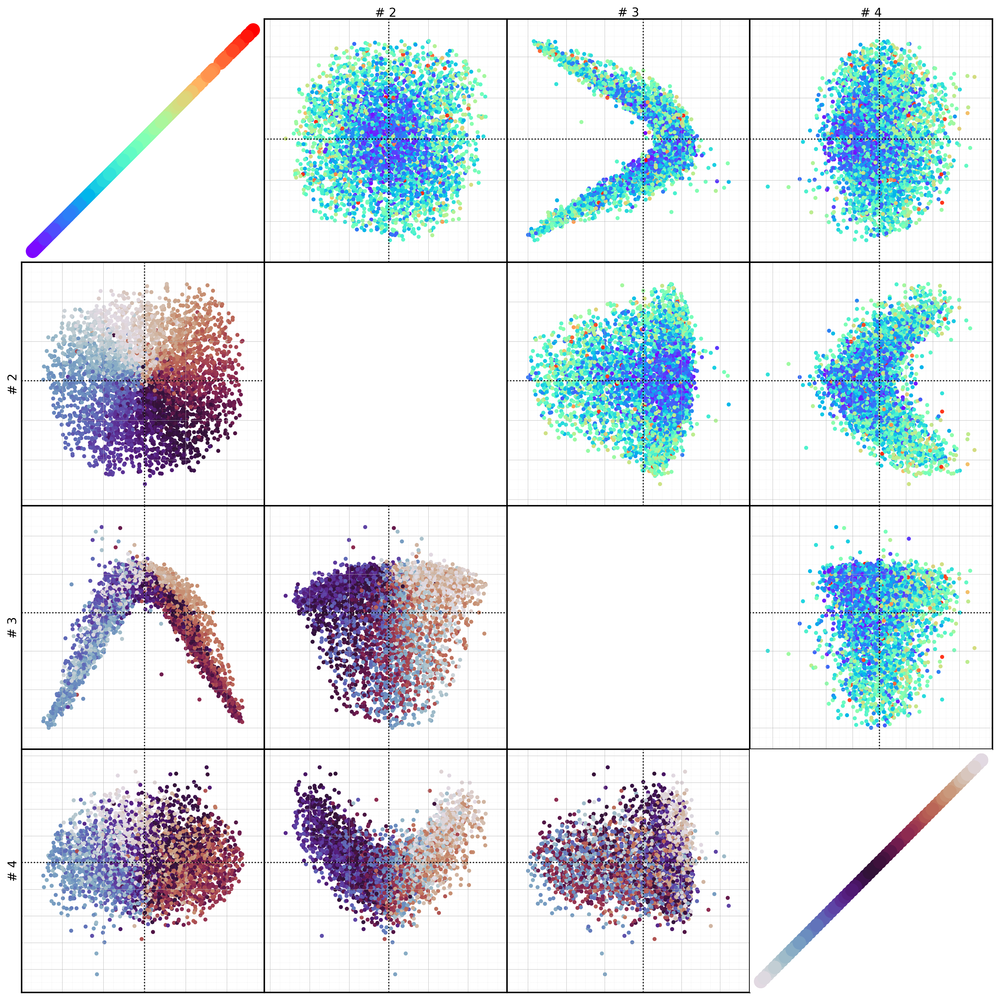

In [37]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
run_cell=True
if run_cell:
    viz.biplots(U_curated, prj2=U_curated,
                n=4, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname,
                colorbar_size=500
               )
Image(figname)

# Parameter prediction with truncated PCA

In [27]:
angle_true   = angle_curated + 180
defocus_true = defocus_curated

In [28]:
U_truncated = U_curated[:,0:3]

## circle prediction

In [29]:
angle_pred, defocus_pred = pred.pred2d(U_truncated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=False)

In [30]:
def pred2d_tmp(X,  angle_true, defocus_true,
               angle_pred_sign=1.0,
               defocus_min=0.5,defocus_max=2.5,
               defocus_rescale='minmax',
              do_ellipse=False):
    """
    """
    if do_ellipse:
        center, axis, theta_0, score= fitEllipse(X[:,0:2])
        a       = np.max(axis)
        b       = np.min(axis)
        e       = np.sqrt(1.0 - (b/a)**2)
        rho_centered, theta = cart2sph(X[:,0]-center[0], X[:,1]-center[1])
        rho_ellipse = b/(np.sqrt(1. - (e*np.cos(theta-theta_0))**2))
        rho = rho_centered/rho_ellipse
    else:
        rho, theta = pred.cart2pol(X[:,0], X[:,1])
    #
    angle_pred         = np.mod(angle_pred_sign*(180*theta/np.pi + 180) + 360, 360) 
    #
    rho_normalized = pred.rescale_to_zero_one(rho)
    if(defocus_rescale=='minmax'):
        a = defocus_max - defocus_min
        b = defocus_min
    elif(defocus_rescale=='quartile'):
        Q1_true, Q3_true = np.percentile(defocus_true, [25,75])
        Q1_pred, Q3_pred = np.percentile(rho_normalized, [25,75])
        a = (Q3_true - Q1_true)/(Q3_pred - Q1_pred)
        b = Q1_true - a*Q1_pred
    defocus_predicted  = a*rho_normalized + b
    return angle_pred, defocus_predicted

In [31]:
angle_pred, defocus_pred = pred.pred2d(U_truncated, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_rescale='quartile')

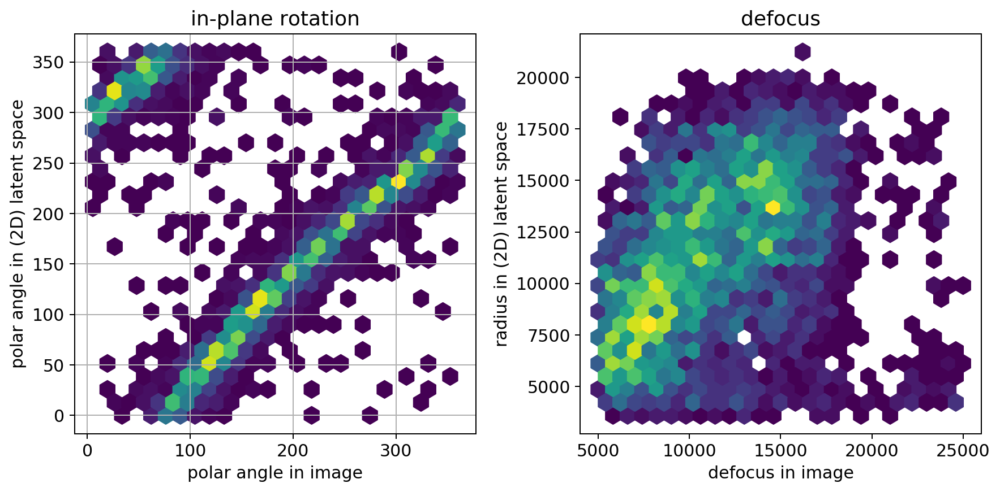

In [32]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_circle')

offset: 68.0 angle RMSE = 28.161295845458557
offset: 68.25 angle RMSE = 28.161846204470024
offset: 68.5 angle RMSE = 28.164615736647356
offset: 68.75 angle RMSE = 28.169603787447656
offset: 69.0 angle RMSE = 28.17680917865908
offset: 69.25 angle RMSE = 28.18623020979123
offset: 69.5 angle RMSE = 28.19786466007894
offset: 69.75 angle RMSE = 28.211709791094023
offset: 70.0 angle RMSE = 28.22776234995774
offset: 70.25 angle RMSE = 28.246018573145363
offset: 70.5 angle RMSE = 28.266474190872376
offset: 70.75 angle RMSE = 28.289124432050475
offset: 71.0 angle RMSE = 28.313964029800143
offset: 71.25 angle RMSE = 28.34098722750493
offset: 71.5 angle RMSE = 28.37018778539153
offset: 71.75 angle RMSE = 28.401558987618266
defocus RMSE = 4468.417635083814


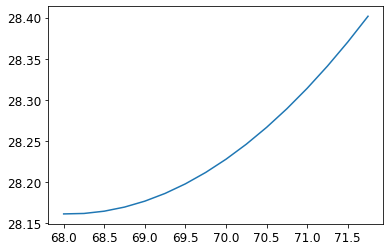

In [33]:
offset_range = np.arange(68,72,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted circle prediction

In [34]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: 65.0 angle RMSE = 18.14812557928788
offset: 65.25 angle RMSE = 18.128160281962643
offset: 65.5 angle RMSE = 18.111623592313798
offset: 65.75 angle RMSE = 18.098525439887403
offset: 66.0 angle RMSE = 18.088873294218985
offset: 66.25 angle RMSE = 18.082672673524492
offset: 66.5 angle RMSE = 18.07992712896857
offset: 66.75 angle RMSE = 18.080638234511007
offset: 67.0 angle RMSE = 18.08480558239907
offset: 67.25 angle RMSE = 18.092426784335693
offset: 67.5 angle RMSE = 18.103497478315784
offset: 67.75 angle RMSE = 18.118011341085086
offset: 68.0 angle RMSE = 18.13596010613867
offset: 68.25 angle RMSE = 18.15733358714
offset: 68.5 angle RMSE = 18.182119706606677
offset: 68.75 angle RMSE = 18.210304529675803
offset: 69.0 angle RMSE = 18.24187230273117
offset: 69.25 angle RMSE = 18.276805496646123
offset: 69.5 angle RMSE = 18.3150848543702
offset: 69.75 angle RMSE = 18.35668944256537
defocus RMSE = 4468.417635083814


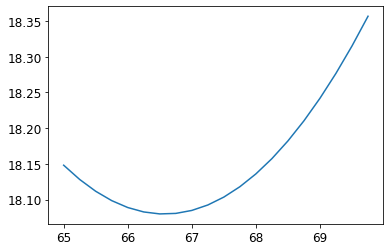

In [35]:
offset_range = np.arange(65,70,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## ellipse prediction

In [36]:
angle_pred, defocus_pred = pred.pred2d(U_truncated, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

TypeError: cart2sph() missing 1 required positional argument: 'z'

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_ellipse')

In [ ]:
offset_range = np.arange(0,25,2)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted ellipse prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(0,25,2)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (2D)

*Careful!* We get rid of the first dimension here...

In [ ]:
U_best = pred.rotate_to_fit_cone(U_truncated,10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_truncated_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=3, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.subplot(2,3,1)
plt.hexbin(U_truncated[:,0],np.linalg.norm(U_truncated[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,2)
plt.hexbin(U_truncated[:,1],np.linalg.norm(U_truncated[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,3)
plt.hexbin(U_truncated[:,2],np.linalg.norm(U_truncated[:,0:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,4)
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,5)
plt.hexbin(U_best[:,1],np.linalg.norm(U_best[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,6)
plt.hexbin(U_best[:,2],np.linalg.norm(U_best[:,0:2],axis=1), mincnt=1, gridsize=30)

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_truncated_prediction_cone')

In [ ]:
offset_range = np.arange(123,126,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range =  np.arange(250,255,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

# Parameter prediction with full PCA

## circle prediction

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=False)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_circle')

In [ ]:
offset_range = np.arange(25,28,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted circle prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(52,58,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## ellipse prediction

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_curated, angle_true, defocus_true, 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_ellipse')

In [ ]:
offset_range = np.arange(22,26,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

## weighted ellipse prediction

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range = np.arange(100,104,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), 
                                                norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (2D)

*Careful!* We get rid of the first dimension here...

In [ ]:
U_best = pred.rotate_to_fit_cone_2d(U_curated[:,1:],10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_pickdim_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=3, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.subplot(2,3,1)
plt.hexbin(U_curated[:,0],np.linalg.norm(U_curated[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,2)
plt.hexbin(U_curated[:,1],np.linalg.norm(U_curated[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,3)
plt.hexbin(U_curated[:,2],np.linalg.norm(U_curated[:,0:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,4)
plt.hexbin(U_best[:,0],np.linalg.norm(U_best[:,1:3],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,5)
plt.hexbin(U_best[:,1],np.linalg.norm(U_best[:,0:3:2],axis=1), mincnt=1, gridsize=30)
plt.subplot(2,3,6)
plt.hexbin(U_best[:,2],np.linalg.norm(U_best[:,0:2],axis=1), mincnt=1, gridsize=30)

In [ ]:
angle_pred, defocus_pred = pred.pred2d(U_best, angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

In [ ]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                figname=KEYWORD+'/polar_prediction_cone')

In [ ]:
offset_range = np.arange(123,126,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range)
plt.plot(offset_range,angle_RMSE_list)

In [ ]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

In [ ]:
offset_range =  np.arange(250,255,0.25)
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=offset_range,
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(offset_range,angle_RMSE_list)

## cone prediction (any dimension)

In [ ]:
U_best = pred.rotate_to_fit_cone(U_curated,10000)

In [ ]:
figname=KEYWORD+'/latent_space_pca_curated_t{}_cone_rotated_biplot.png'.format(measure_threshold)
#
run_cell=False
if os.path.exists(figname):
    if fig_force_update:
        run_cell=True
else:
    run_cell=True
#
run_cell=True
if run_cell:
    viz.biplots(U_best, prj2=U_best,
                n=4, nbins=100,
                c=defocus_curated,
                c2=angle_curated, c2map='twilight',
                show_histo=False,
                minortick=np.std(U_curated[:,0])/2,
                majortick=np.std(U_curated[:,0]),
                figname=figname
               )
Image(figname)

# the end

In [ ]:
def rotate_to_fit_cone(X,ntry):
    dim = X.shape[1]
    score_list = []
    rotmat = np.identity(dim) #np.diag([1,1,1])
    X_rotated = np.dot(rotmat,X.T).T
    dist = pred.rescale_to_zero_one(np.linalg.norm(X_rotated[:,0:dim-1],axis=1))
    popt, pcov = pred.curve_fit(pred.linear_1d, X_rotated[:,dim-1], dist)
    score = np.abs(popt[0])
    #
    score_max  = score
    rotmat_max = rotmat
    ibest = 0
    score_list.append(score)
    #
    print('   current best ({}/{}): {}'.format(ibest,ntry,score_max))
    for i in np.arange(1,ntry):
        rotmat = pred.special_ortho_group.rvs(dim)
        X_rotated = np.dot(rotmat,X.T).T
        dist = pred.rescale_to_zero_one(np.linalg.norm(X_rotated[:,0:dim-1],axis=1))
        popt, pcov = pred.curve_fit(pred.linear_1d, X_rotated[:,dim-1], dist)
        score = np.abs(popt[0])
        if(score > score_max):
            score_max = score
            ibest = i
            rotmat_max = rotmat
            print('   current best ({}/{}): {}'.format(ibest,ntry,score_max))
        score_list.append(score)
    X_best = np.dot(rotmat_max, X.T).T
    fig = plt.figure()
    plt.hist(score_list, bins=np.int(ntry/10))
    plt.show()
    return X_best
